<a href="https://colab.research.google.com/github/soumindar/car-distance-estimation/blob/main/skripsi.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# import library
import numpy as np
import cv2
import glob
import codecs
import json
import matplotlib.pyplot as plt
from decimal import Decimal
from google.colab.patches import cv2_imshow

In [ ]:
# Memuat Citra
fname = "/content/drive/MyDrive/Skripsi/Penelitian/sma2/xenia putih/05_15.jpg"
img = cv2.imread(fname)

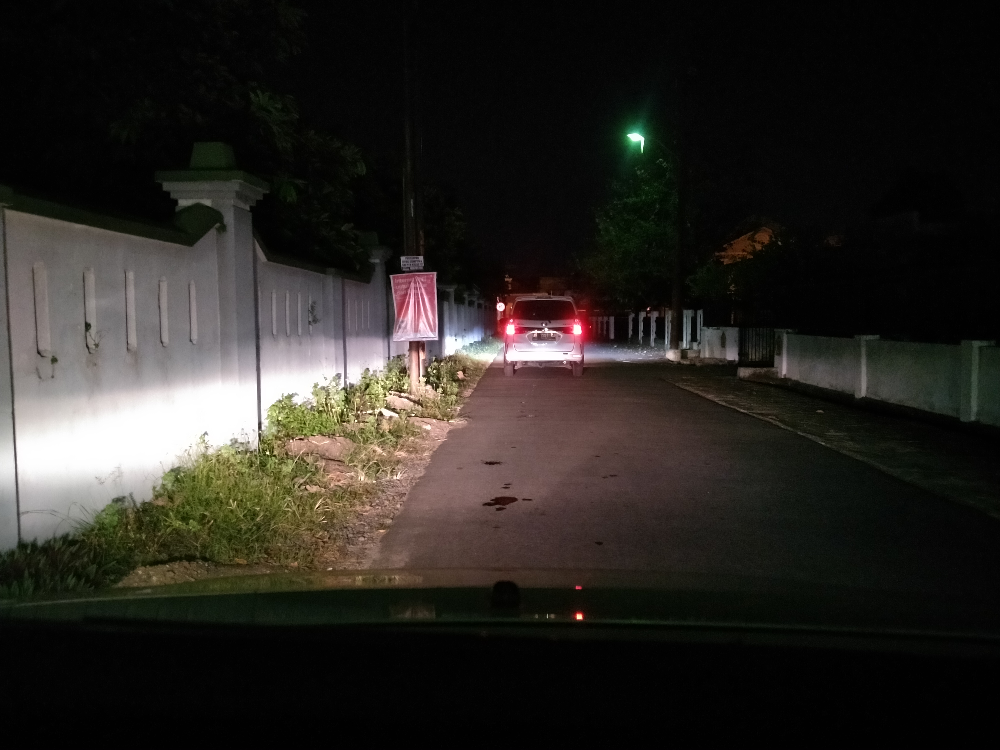

In [ ]:
cv2_imshow(img)

In [ ]:
# Mengambil ROI
top_crop = 600
bottom_crop = 2400
left_crop = 800
right_crop = 3200
roi = img[top_crop:bottom_crop, left_crop:right_crop]

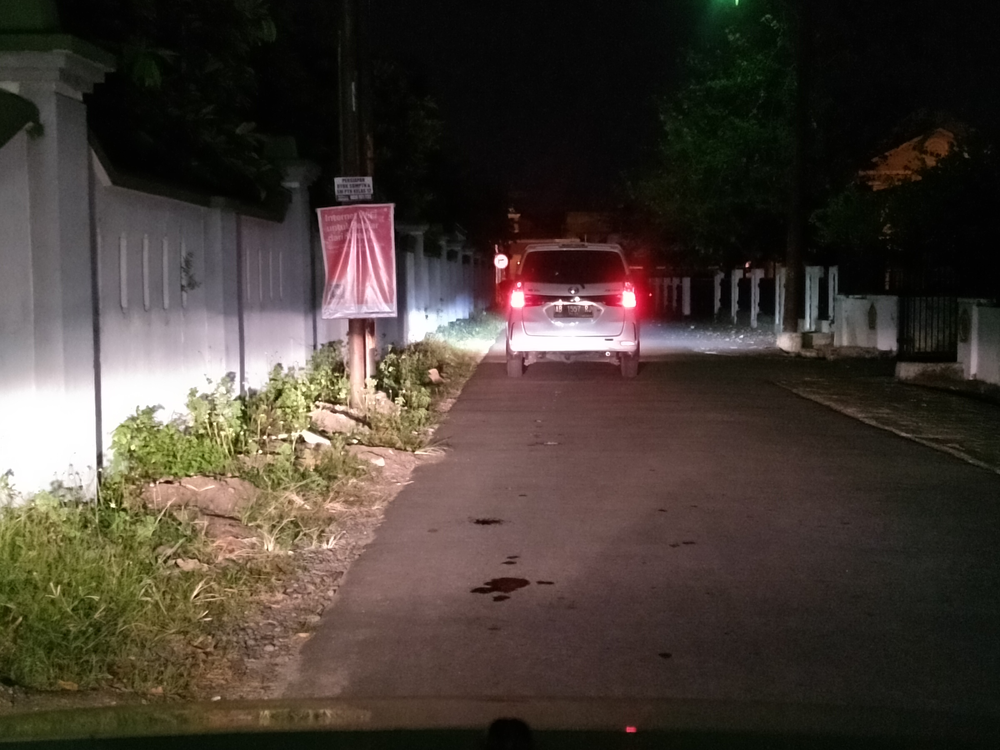

In [ ]:
cv2_imshow(roi)

In [ ]:
# Konversi dari BGR ke HSV
hsv = cv2.cvtColor(roi, cv2.COLOR_BGR2HSV)

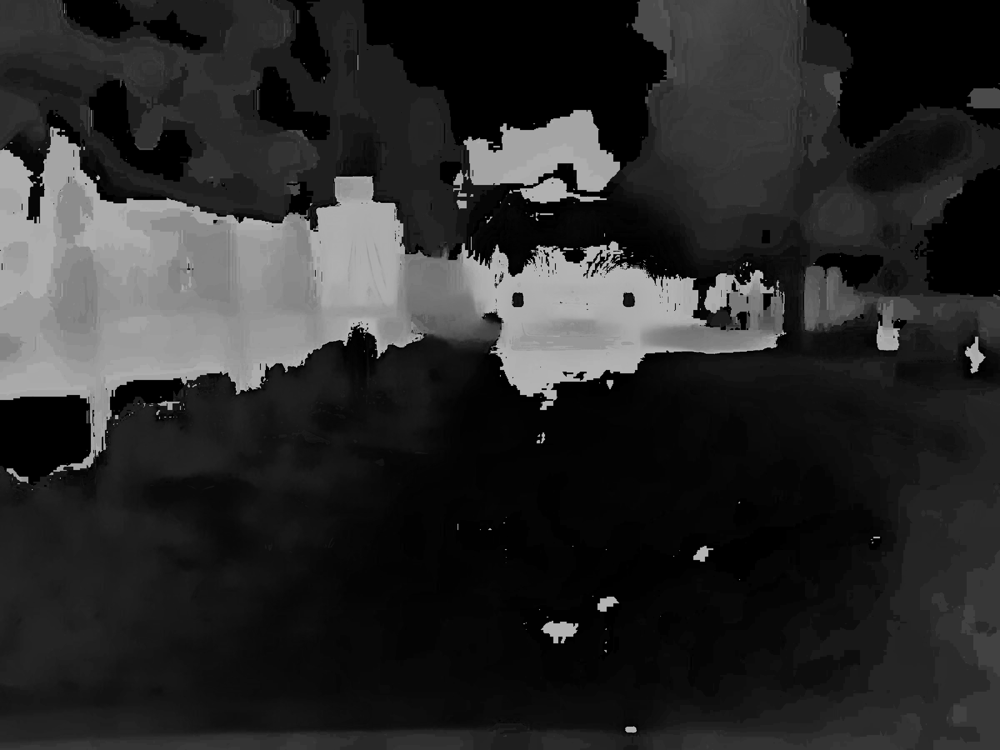

In [ ]:
cv2_imshow(hsv[:, :, 0])

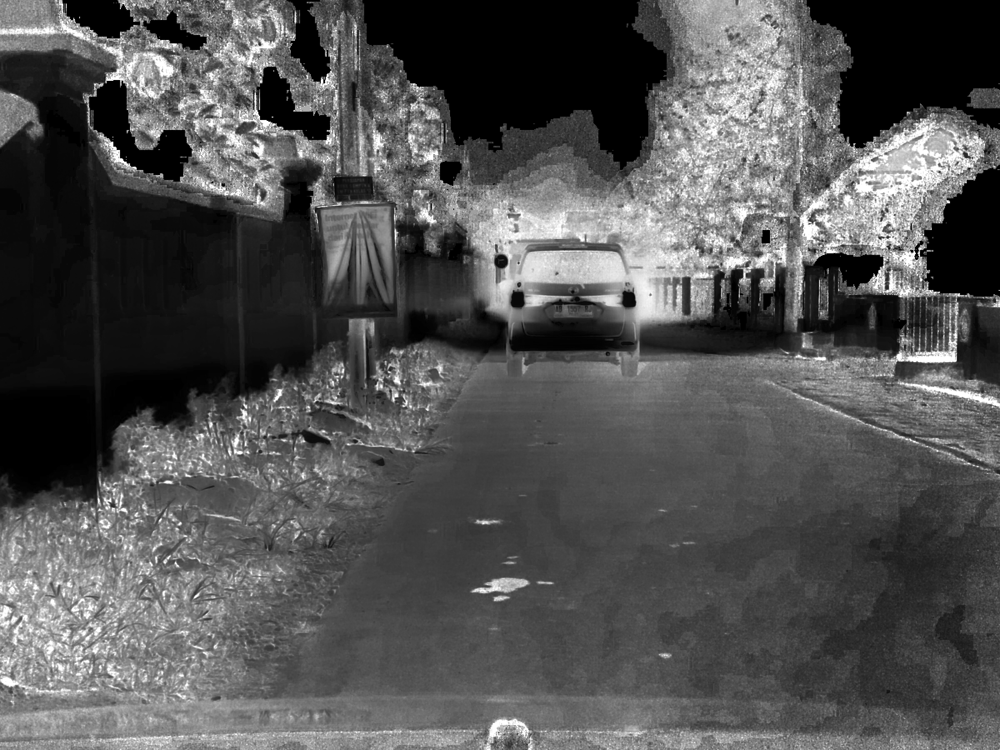

In [ ]:
cv2_imshow(hsv[:, :, 1])

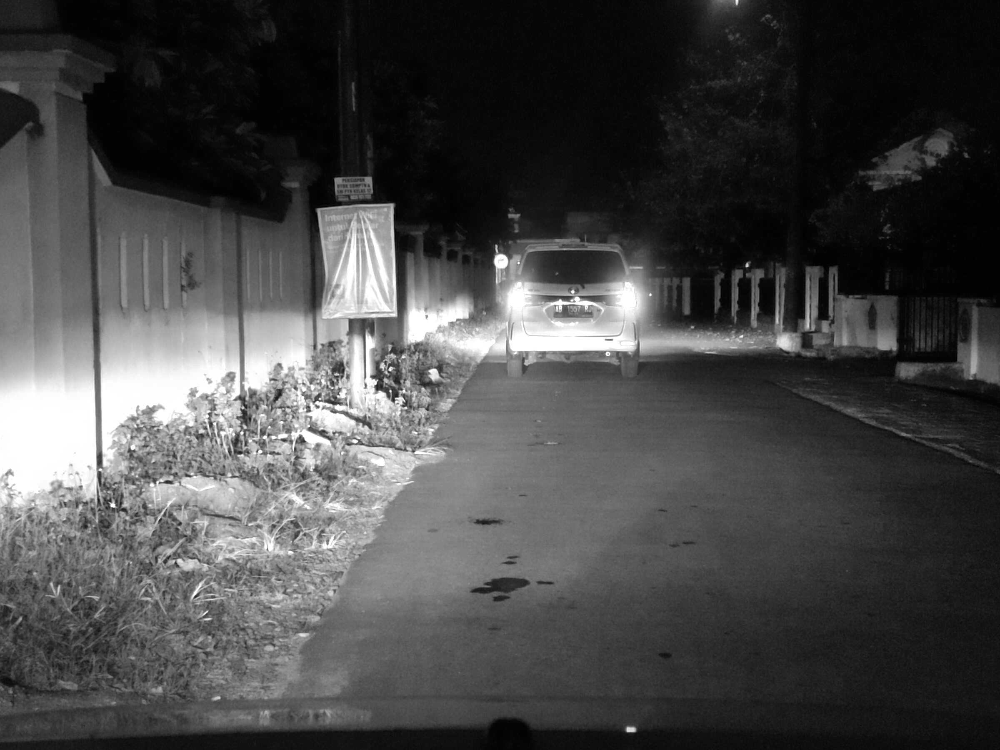

In [ ]:
cv2_imshow(hsv[:, :, 2])

In [ ]:
# Filtering Warna Merah
lower_red = np.array([0,120,190])
upper_red = np.array([10,255,255])
mask1 = cv2.inRange(hsv, lower_red, upper_red)

lower_red = np.array([170,120,190])
upper_red = np.array([180,255,255])
mask2 = cv2.inRange(hsv,lower_red,upper_red)

mask = mask1 + mask2

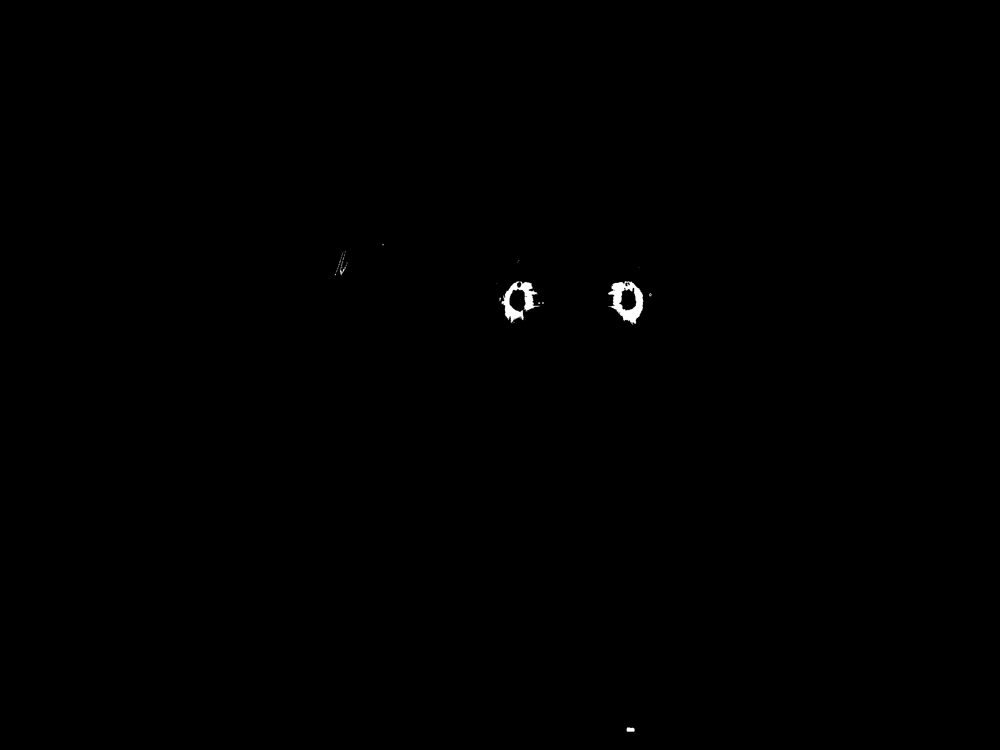

In [ ]:
cv2_imshow(mask)

In [ ]:
# Smoothing & Thresholding
smoothed = mask
for i in range(4):
  smoothed = cv2.GaussianBlur(smoothed,(5,5),0)
  ret, smoothed = cv2.threshold(smoothed, 120, 255, cv2.THRESH_BINARY)

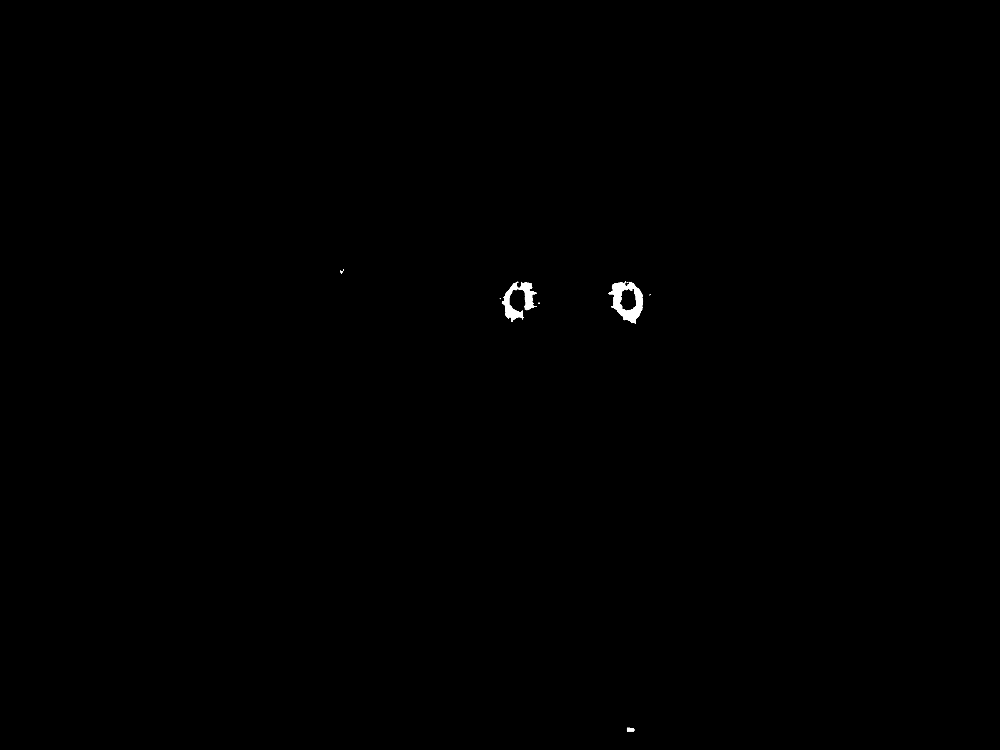

In [ ]:
cv2_imshow(smoothed)

In [ ]:
# Connected Component Analysis
num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(smoothed, 8)

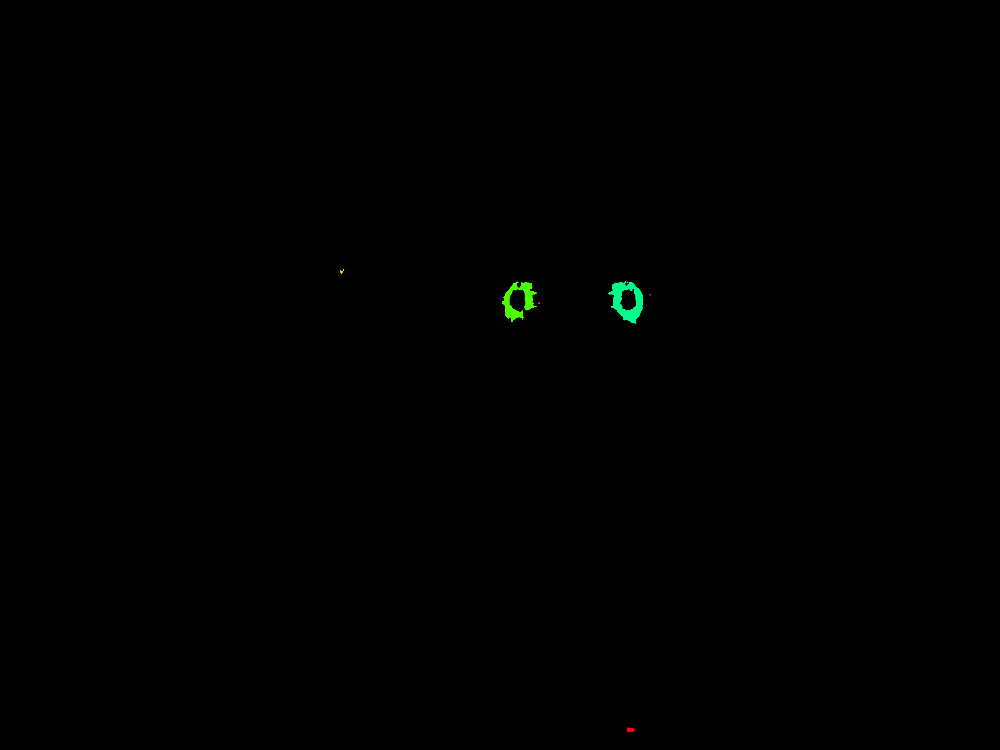

In [ ]:
label_hue = np.uint8(179*labels/np.max(labels))
blank_ch = 255*np.ones_like(label_hue)
labeled_img = cv2.merge([label_hue, blank_ch, blank_ch])
labeled_img = cv2.cvtColor(labeled_img, cv2.COLOR_HSV2BGR)
labeled_img[label_hue==0] = 0

cv2_imshow(labeled_img)

In [ ]:
# Membentuk Bounding Boxes dari Objek Merah
bounding_box_red_obj = cv2.cvtColor(smoothed, cv2.COLOR_GRAY2RGB)
for i in range(1, num_labels):
  left = stats[i, cv2.CC_STAT_LEFT]
  top = stats[i, cv2.CC_STAT_TOP]
  right = stats[i, cv2.CC_STAT_LEFT] + stats[i, cv2.CC_STAT_WIDTH]
  bottom = stats[i, cv2.CC_STAT_TOP] + stats[i, cv2.CC_STAT_HEIGHT]
  color = (0, 255, 0)
  thickness = 2
  bounding_box_red_obj = cv2.rectangle(bounding_box_red_obj, (left, top), (right, bottom), color, thickness)

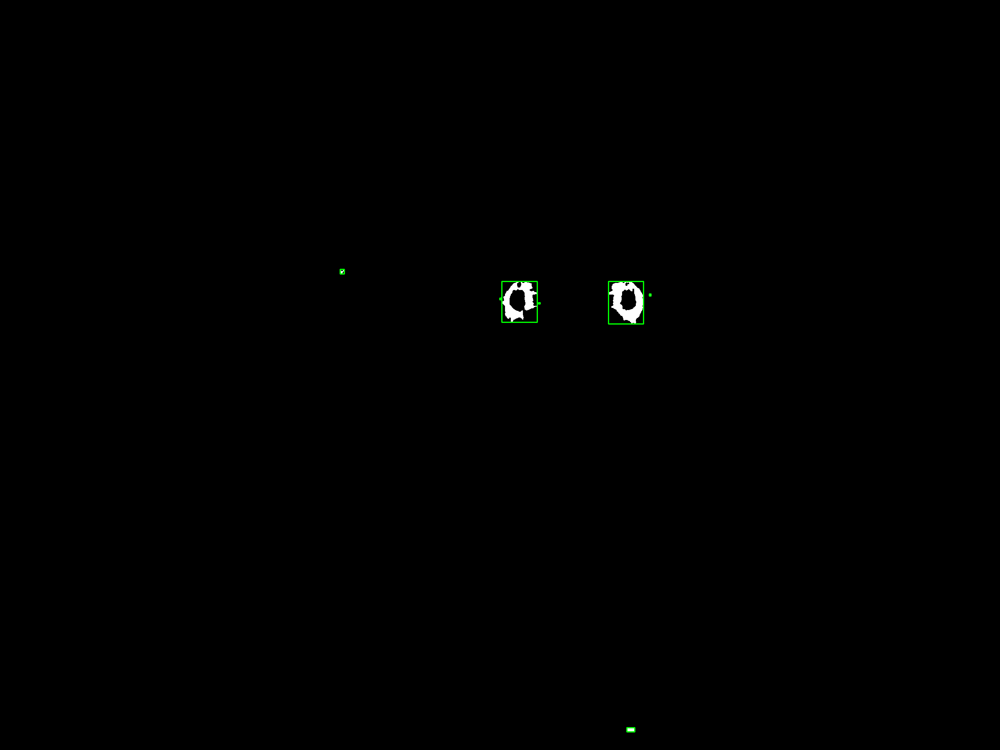

In [ ]:
cv2_imshow(bounding_box_red_obj)

Estimasi jarak:  15.734223529411762
Error absolut:  0.7342235294117625


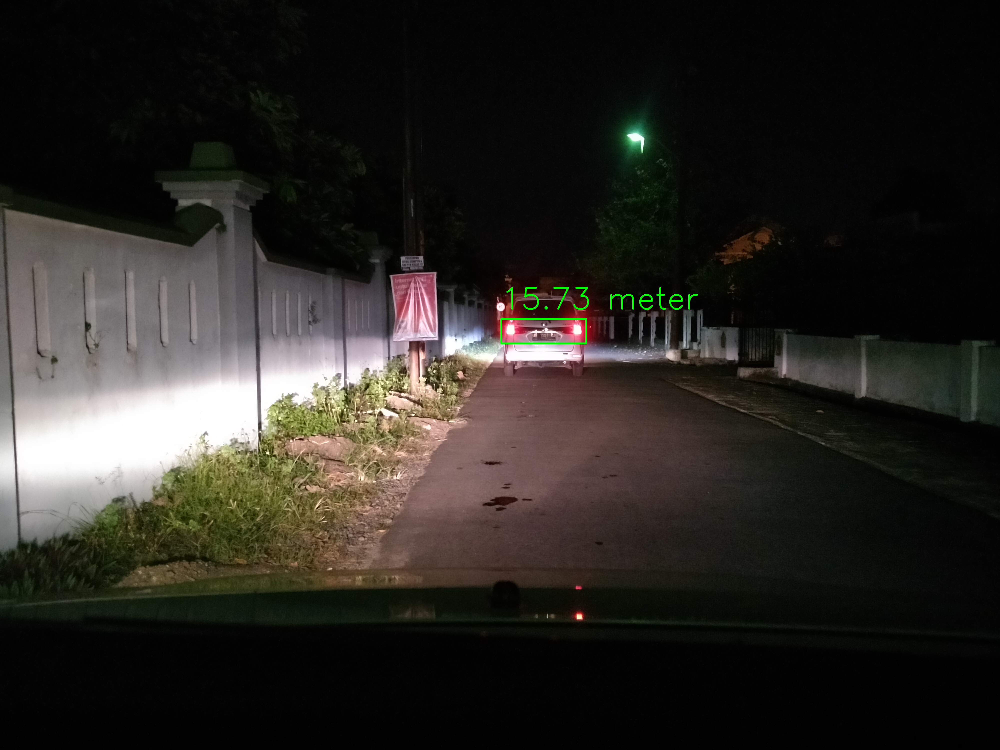

In [ ]:
# Memasangkan Lampu Belakang

if (num_labels < 3):
  print("Tidak ada mobil yang terdeteksi")
  exit

max_distance_x = -1
for i in range(1, num_labels):
  width_i = stats[i, cv2.CC_STAT_WIDTH]
  height_i = stats[i, cv2.CC_STAT_HEIGHT]
  for j in range(i+1, num_labels):
    width_j = stats[j, cv2.CC_STAT_WIDTH]
    height_j = stats[j, cv2.CC_STAT_HEIGHT]
    distance_x = abs(centroids[i,0] - centroids[j,0])
    distance_y = abs(centroids[i,1] - centroids[j,1])

    if width_i > (0.60 * width_j) and width_i < (1.40 * width_j):
      if height_i > (0.60 * height_j) and height_i < (1.40 * height_j):
        if distance_y < (0.3 * height_i):
          if distance_x > (3 * width_i) and distance_x < (10 * width_i):
            if distance_x > max_distance_x:
              max_distance_x = distance_x
              pair_of_tail_light = (i, j)

# Jika Kendaraan Terdeteksi
if max_distance_x > 0:
  
  # Membentuk Bounding Box
  first_obj = pair_of_tail_light[0]
  second_obj = pair_of_tail_light[1]
  if stats[first_obj, cv2.CC_STAT_LEFT] < stats[second_obj, cv2.CC_STAT_LEFT]:
    left_pt = stats[first_obj, cv2.CC_STAT_LEFT]
    right_pt = stats[second_obj, cv2.CC_STAT_LEFT] + stats[second_obj, cv2.CC_STAT_WIDTH]
  else:
    left_pt = stats[second_obj, cv2.CC_STAT_LEFT]
    right_pt = stats[first_obj, cv2.CC_STAT_LEFT] + stats[first_obj, cv2.CC_STAT_WIDTH]

  if stats[first_obj, cv2.CC_STAT_TOP] < stats[second_obj, cv2.CC_STAT_TOP]:
    top_pt = stats[first_obj, cv2.CC_STAT_TOP]
    bottom_pt = stats[second_obj, cv2.CC_STAT_TOP] + stats[second_obj, cv2.CC_STAT_HEIGHT]
  else:
    top_pt = stats[second_obj, cv2.CC_STAT_TOP]
    bottom_pt = stats[first_obj, cv2.CC_STAT_TOP] + stats[first_obj, cv2.CC_STAT_HEIGHT]

  left_pt = left_pt + left_crop
  right_pt = right_pt + left_crop
  top_pt = top_pt + top_crop
  bottom_pt = bottom_pt + top_crop

  bounding_box_width = right_pt - left_pt

  car_detected = img.copy()
  color = (0, 255, 0)
  thickness = 6
  car_detected = cv2.rectangle(car_detected, (left_pt, top_pt), (right_pt, bottom_pt), color, thickness)

  # Jarak Asli
  actual_dist = int(fname[-6:-4])

  # Estimasi Jarak
  focal_length = 3258
  actual_car_width = 1.642
  estimated_dist = focal_length * actual_car_width / bounding_box_width
  abs_error = abs(actual_dist - estimated_dist)

  font = cv2.FONT_HERSHEY_SIMPLEX
  cv2.putText(car_detected, str(round(Decimal(estimated_dist),2)) + ' meter', (left_pt, top_pt - 40), font, 4, (0, 255, 0), 6)

  # output image
  print("Estimasi jarak: ", estimated_dist)
  print("Error absolut: ", abs_error)
  cv2_imshow(car_detected)

# jika kendaraan tidak terdeteksi
else:
  print("Tidak ada kendaraan yang terdeteksi")